In [1]:
import numpy as np
import pandas as pd
import pickle

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [2]:
with open('data_after_lda.pkl', 'rb') as f:
    data = pickle.load(f)

In [3]:
data.head()

,id,date,comments,host_id,host_since,neighbourhood_cleansed,city,latitude,longitude,number_of_reviews,...,sentences_to_tokens,sentences_to_tokens_regex,token_lemmatized,tokens_lemmatized,sentence_countdata,corpus,sentence_topics,highest_prob,topic_highest_prob,no_of_topics
2779359,6914699,2016-03-12,Cozy and charming historical house in the cent...,29544201,2015-03-18,东城区,Beijing,39.94292,116.42102,73,...,"[[Cozy, and, charming, historical, house, in, ...","[[Cozy, and, charming, historical, house, in, ...","[[[cozy, charm, historical, house, center]], [...","[[cozy, charm, historical, house, center], [ro...",4,"[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1)], [(5...","[[(0, 0.016671542), (1, 0.016671542), (2, 0.38...","[0.48389202, 0.69696486, 0.6833173, None]","[5, 5, 4, None]",4
2795589,32997950,2019-07-25,This is a lovely shared apartment. You have yo...,46840971,2015-10-18,东城区,Beijing,39.91785,116.41532,43,...,"[[This, is, a, lovely, shared, apartment, .], ...","[[This, is, a, lovely, shared, apartment], [Yo...","[[[lovely, share, apartment]], [[individual, e...","[[lovely, share, apartment], [individual, ensu...",6,"[[(16, 1), (17, 1), (18, 1)], [(19, 1), (20, 1...","[[(0, 0.02500063), (1, 0.025002021), (2, 0.025...","[0.52498126, 0.6999252, 0.56430054, 0.6999982,...","[3, 4, 4, 5, 8, None]",6
2779597,7239103,2016-04-06,"The house is wonderfully designed , especially...",29544201,2015-03-18,东城区,Beijing,39.94314,116.41417,95,...,"[[The, house, is, wonderfully, designed, espec...","[[The, house, is, wonderfully, designed, espec...","[[[house, wonderfully, design, especially, lov...","[[house, wonderfully, design, especially, love...",12,"[[(4, 1), (29, 1), (30, 1), (31, 1), (32, 1), ...","[[(0, 0.010002318), (1, 0.010002845), (2, 0.01...","[0.30998474, 0.36663064, 0.27567026, 0.5057822...","[5, 4, 8, 9, 9, 0, 1, 1, None, 7, 8, None]",12
2797750,39686549,2019-11-11,"Good room, everything seemed clean, enough spa...",209023661,2018-08-12,海淀区,Beijing,39.99353,116.34111,16,...,"[[Good, room, everything, seemed, clean, enoug...","[[Good, room, everything, seemed, clean, enoug...","[[[good, room, clean, space, people, big, soli...","[[good, room, clean, space, people, big, solid...",5,"[[(5, 1), (9, 1), (76, 1), (77, 1), (78, 1), (...","[[(0, 0.011113217), (1, 0.0111141605), (2, 0.0...","[0.4649354, 0.4198707, 0.34999582, 0.6744321, ...","[5, 8, 2, 6, None]",5
2790780,24239168,2018-07-15,Lu was very welcoming and his command of Engli...,127613055,2017-04-25,西城区,Beijing,39.89151,116.32731,18,...,"[[Lu, was, very, welcoming, and, his, command,...","[[Lu, was, very, welcoming, and, his, command,...","[[[welcoming, command, mean, good, host, forei...","[[welcoming, command, mean, good, host, foreig...",7,"[[(78, 1), (94, 1), (95, 1), (96, 1), (97, 1),...","[[(0, 0.014297143), (1, 0.5399673), (2, 0.0142...","[0.5399673, 0.39901915, 0.51673675, 0.51670337...","[1, 1, 9, 2, 1, 8, None]",7


In [173]:
data.sentences_to_tokens_regex.tolist()[:1]

/home/natalia/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[[['Cozy',
   'and',
   'charming',
   'historical',
   'house',
   'in',
   'the',
   'center',
   'of',
   'Beijing'],
  ['Room',
   'is',
   'warm',
   'and',
   'clean',
   'the',
   'living',
   'room',
   'is',
   'decorated',
   'really',
   'nice'],
  ['It',
   'is',
   'quiet',
   'at',
   'night',
   'suitable',
   'for',
   'those',
   'who',
   'are',
   'not',
   'easy',
   'to',
   'sleep'],
  ['gps']]]

### Number of reviews in Western

In [21]:
data[data.type=='western'].shape

(40000, 32)

### Number of reviews in non Western

In [22]:
data[data.type=='non western'].shape

(90000, 32)

### Number of sentences in Western

In [25]:
data[data.type=='western']['no_of_topics'].sum()

168200

### Number of sentences in non Western

In [26]:
data[data.type=='non western']['no_of_topics'].sum()

420973

## Assign number of words in review to each sentence in that review WESTERN

In [11]:
def filter_none(L):
    return [x for x in L if x is not None]
topic_with_sentences_df_western = data[data.type=='western'].apply(lambda row: dict([(topic, row['num_words']) 
                                                                                     for topic in set(filter_none(row['topic_highest_prob']))]), axis=1)

In [19]:
topic_with_sentences_df_non_western = data[data.type=='non western'].apply(lambda row: dict([(topic, row['num_words']) 
                                                                                     for topic in set(filter_none(row['topic_highest_prob']))]), axis=1)

In [12]:
topic_with_sentences_df_western

510433                         {8: 53, 1: 53, 6: 53, 0: 53}
787332                                       {0: 25, 5: 25}
253929                         {0: 75, 1: 75, 2: 75, 5: 75}
356202                                {1: 29, 3: 29, 6: 29}
76568                          {9: 57, 2: 57, 3: 57, 5: 57}
                                 ...                       
2724634          {0: 77, 1: 77, 2: 77, 5: 77, 6: 77, 8: 77}
2617508                               {8: 37, 9: 37, 2: 37}
2643650    {1: 131, 4: 131, 5: 131, 6: 131, 7: 131, 9: 131}
2723255                               {4: 75, 5: 75, 6: 75}
2657506                                             {2: 18}
Length: 40000, dtype: object

In [20]:
topic_with_sentences_df_non_western

2779359                                       {4: 37, 5: 37}
2795589                         {8: 34, 3: 34, 4: 34, 5: 34}
2779597    {0: 140, 1: 140, 4: 140, 5: 140, 7: 140, 8: 14...
2797750                         {8: 49, 2: 49, 5: 49, 6: 49}
2790780                     {8: 100, 1: 100, 2: 100, 9: 100}
                                 ...                        
3542392                                {2: 33, 5: 33, 6: 33}
3624824                         {9: 65, 4: 65, 5: 65, 6: 65}
3622002                                {8: 24, 1: 24, 6: 24}
3588911                                {9: 94, 6: 94, 7: 94}
3545048                         {0: 62, 1: 62, 2: 62, 5: 62}
Length: 90000, dtype: object

In [13]:
topic_with_sentences_western = dict()
for list in topic_with_sentences_df_western.tolist():
    for key, value in list.items():
        b = topic_with_sentences_western.get(key, [])
        b.append(value)
        topic_with_sentences_western[key] = b

In [27]:
topic_with_sentences_non_western = dict()
for list in topic_with_sentences_df_non_western.tolist():
    for key, value in list.items():
        b = topic_with_sentences_non_western.get(key, [])
        b.append(value)
        topic_with_sentences_non_western[key] = b

In [28]:
topic_with_sentences_non_western = dict(sorted(topic_with_sentences_non_western.items()))

In [110]:
topic_ids = set([key for key in topic_with_sentences_western.keys()] + [key for key in topic_with_sentences_non_western.keys()])
topic_merged = {}
for topic_id in topic_ids:
    topic_merged[topic_id] = [topic_with_sentences_western.get(topic_id, []), topic_with_sentences_non_western.get(topic_id, [])]
    

## Plot number of words in review to each sentence in that review

/home/natalia/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


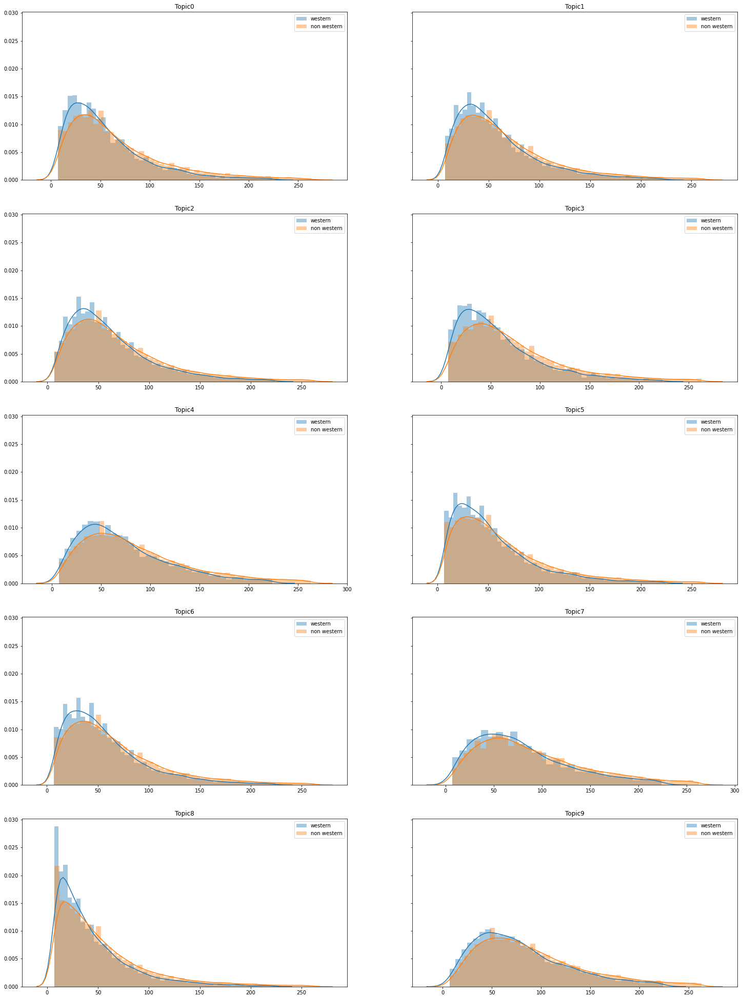

In [171]:
fig, ax = plt.subplots(5, 2, figsize=(25, 35), sharey=True)

i=0
j=0
for key, val in topic_merged.items():
    sns.distplot(val[0], ax=ax[i, j], label='western')
    sns.distplot(val[1], ax=ax[i, j], label='non western')
    ax[i, j].set_title('Topic' + str(key))
    ax[i, j].legend()
    j = j + 1
    if j > 1: 
        i = i + 1
        j = 0

plt.show()

In [ ]:
from matplotlib.ticker import FuncFormatter

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4), dpi=120, sharey=True)

# Topic Distribution by Dominant Topics
ax1.bar(x='Dominant_Topic', height='count', data=df_dominant_topic_in_each_doc, width=.5, color='firebrick')
ax1.set_xticks(range(df_dominant_topic_in_each_doc.Dominant_Topic.unique().__len__()))
tick_formatter = FuncFormatter(lambda x, pos: 'Topic ' + str(x)+ '\n' + df_top3words.loc[df_top3words.topic_id==x, 'words'].values[0])
ax1.xaxis.set_major_formatter(tick_formatter)
ax1.set_title('Number of Documents by Dominant Topic', fontdict=dict(size=10))
ax1.set_ylabel('Number of Documents')
ax1.set_ylim(0, 1000)

# Topic Distribution by Topic Weights
ax2.bar(x='index', height='count', data=df_topic_weightage_by_doc, width=.5, color='steelblue')
ax2.set_xticks(range(df_topic_weightage_by_doc.index.unique().__len__()))
ax2.xaxis.set_major_formatter(tick_formatter)
ax2.set_title('Number of Documents by Topic Weightage', fontdict=dict(size=10))

plt.show()

In [30]:
from collections import Counter

In [31]:
topics_in_sentences_by_type = data.groupby('type')['topic_highest_prob'].apply(lambda topics: 
                                                                            Counter([item for topic in topics 
                                                                                     for item in topic])).rename('topic_count').reset_index()

In [32]:
topics_in_sentences_by_type.groupby('type')['topic_count'].sum()

type
non western    420973
western        168200
Name: topic_count, dtype: int64

In [33]:
topics_in_sentences_by_type.dropna(inplace=True)

In [34]:
topics_in_sentences_by_type.groupby('type')['topic_count'].sum()

type
non western    364503
western        143815
Name: topic_count, dtype: int64

/home/natalia/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


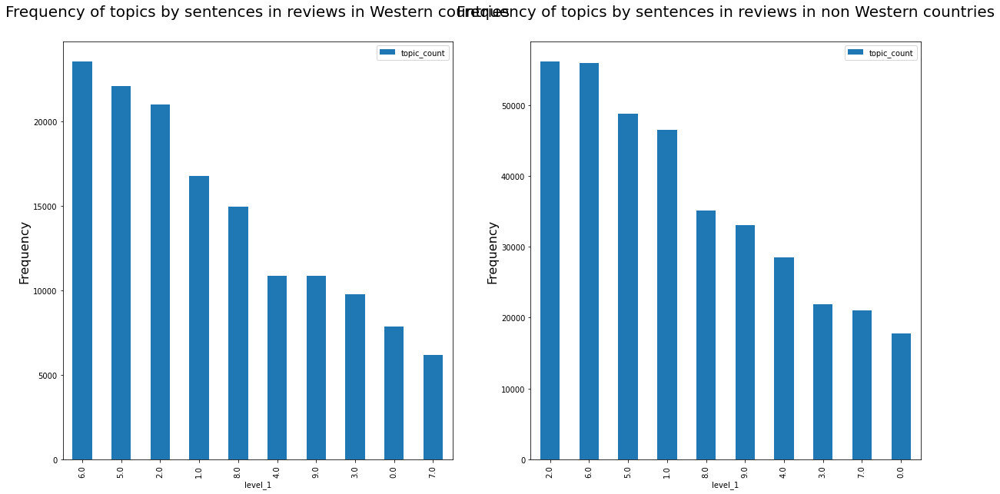

In [183]:
fig, ax = plt.subplots(1, 2, figsize=(20, 15))

ax1 = topics_in_sentences_by_type[topics_in_sentences_by_type.type=='western'].sort_values(by='topic_count', ascending=False).plot(kind='bar', x='level_1', y='topic_count', figsize=(20,10), ax=ax[0])
ax1.set_title('Frequency of topics by sentences in reviews in Western countries', fontdict={'fontsize': '20'}, y=1.05)
ax1.set_ylabel('Frequency', fontdict={'fontsize': '16'})

ax2 = topics_in_sentences_by_type[topics_in_sentences_by_type.type=='non western'].sort_values(by='topic_count', ascending=False).plot(kind='bar', x='level_1', y='topic_count', figsize=(20,10), ax=ax[1])
ax2.set_title('Frequency of topics by sentences in reviews in non Western countries', fontdict={'fontsize': '20'}, y=1.05)
ax2.set_ylabel('Frequency', fontdict={'fontsize': '16'});

In [51]:
topics_in_sentences_by_type[topics_in_sentences_by_type.type=='non western'].sort_values('level_1')

,type,level_1,topic_count
6,non western,0.0,17726
7,non western,1.0,46494
9,non western,2.0,56109
3,non western,3.0,21881
1,non western,4.0,28508
0,non western,5.0,48735
10,non western,6.0,55898
8,non western,7.0,21021
4,non western,8.0,35078
5,non western,9.0,33053


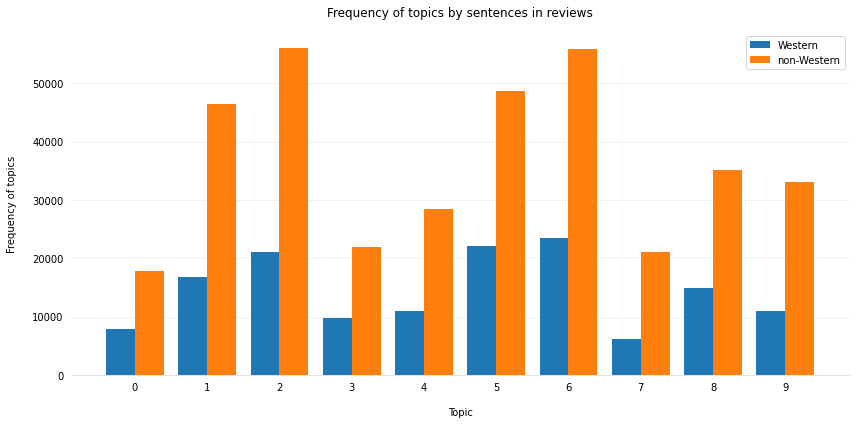

In [54]:
fig, ax = plt.subplots(figsize=(12, 6))

x = np.arange(len(topics_in_sentences_by_type.level_1.unique()))
bar_width = 0.4

b1 = ax.bar(x, topics_in_sentences_by_type[topics_in_sentences_by_type.type=='western'].sort_values('level_1')['topic_count'],
            width=bar_width, label='Western')

b2 = ax.bar(x + bar_width, topics_in_sentences_by_type[topics_in_sentences_by_type.type=='non western'].sort_values('level_1')['topic_count'],
            width=bar_width, label='non-Western')

ax.set_xticks(x + bar_width / 2)
ax.set_xticklabels(sorted(topics_in_sentences_by_type.level_1.astype('int').unique()))

ax.legend()

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')
ax.tick_params(bottom=False, left=False)
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

ax.set_xlabel('Topic', labelpad=15)
ax.set_ylabel('Frequency of topics', labelpad=15)
ax.set_title('Frequency of topics by sentences in reviews', pad=15)

fig.tight_layout()

In [55]:
topics_in_sentences_by_city = data.groupby(['type', 'city'])['topic_highest_prob'].apply(lambda topics: 
                                                                            Counter([item for topic in topics 
                                                                                     for item in topic])).rename('topic_count').reset_index()

In [56]:
topics_in_sentences_by_city

,type,city,level_2,topic_count
0,non western,Beijing,5.0,5443
1,non western,Beijing,4.0,3021
2,non western,Beijing,NaN,6432
3,non western,Beijing,3.0,2000
4,non western,Beijing,8.0,2815
...,...,...,...,...
138,western,Vancouver,0.0,1960
139,western,Vancouver,1.0,3960
140,western,Vancouver,7.0,1498
141,western,Vancouver,2.0,5681


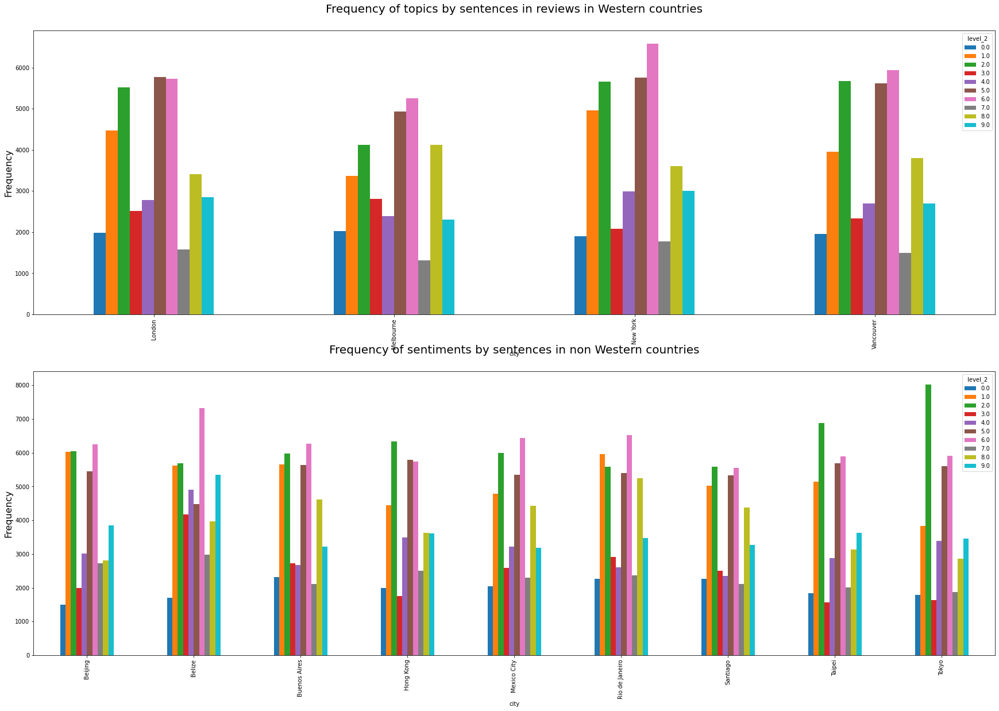

In [57]:
fig, ax = plt.subplots(2, 1, figsize=(25, 25))

ax1 = topics_in_sentences_by_city[topics_in_sentences_by_city.type=='western'].dropna().pivot('city', 'level_2', 'topic_count').plot(kind='bar', figsize=(30,20), ax=ax[0])
ax1.set_title('Frequency of topics by sentences in reviews in Western countries', fontdict={'fontsize': '20'}, y=1.05)
ax1.set_ylabel('Frequency', fontdict={'fontsize': '16'})

ax2 = topics_in_sentences_by_city[topics_in_sentences_by_city.type=='non western'].dropna().pivot('city', 'level_2', 'topic_count').plot(kind='bar', figsize=(30,20), ax=ax[1])
ax2.set_title('Frequency of sentiments by sentences in non Western countries', fontdict={'fontsize': '20'}, y=1.05)
ax2.set_ylabel('Frequency', fontdict={'fontsize': '16'});

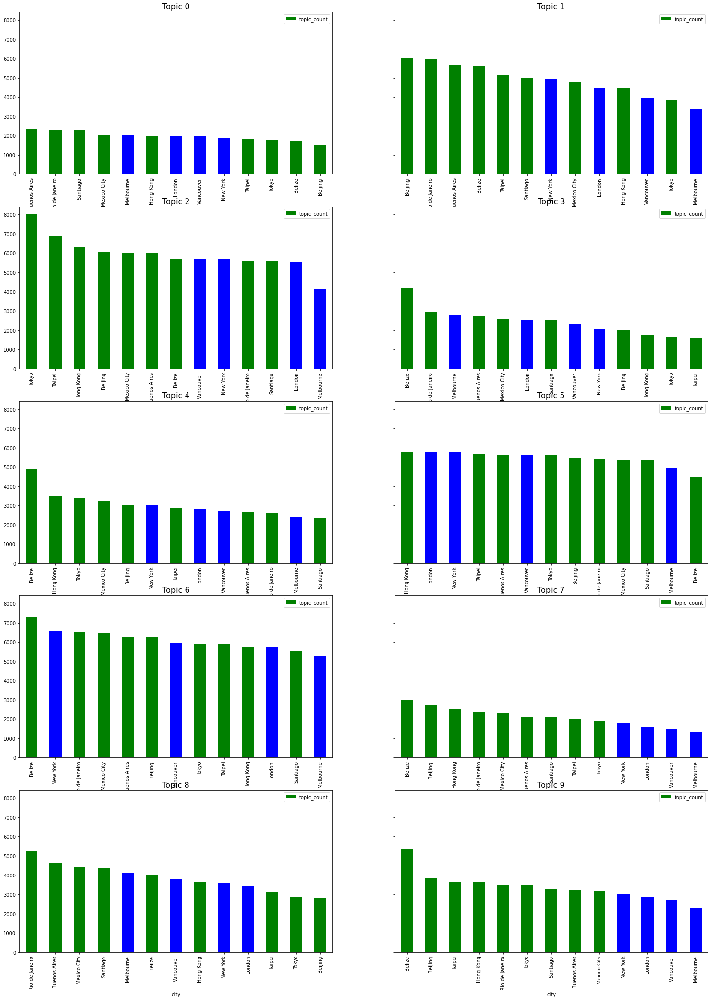

In [41]:
fig, ax = plt.subplots(5, 2, figsize=(25, 35), sharey=True)

i=0
j=0
for topic in sorted(topics_in_sentences_by_city.level_2.dropna().astype('int').unique()):
    
    topic_df = topics_in_sentences_by_city[topics_in_sentences_by_city.level_2==topic].sort_values(by='topic_count', ascending=False)
    topic_df.plot(kind='bar', x='city', y='topic_count', color=topic_df.type.map({'western': 'b', 'non western': 'g'}), ax=ax[i, j])
    ax[i, j].set_title('Topic {}'.format(str(topic)), fontsize=16)
    j = j + 1
    if j > 1: 
        i = i + 1
        j = 0
        
plt.show()

In [74]:
import gensim
lda_model = gensim.models.LdaModel.load('lda.model')

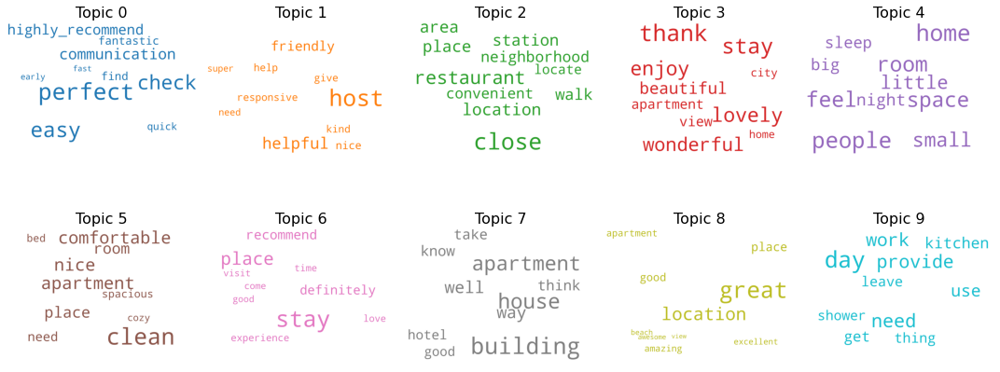

In [79]:
from wordcloud import WordCloud
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(background_color='white',
                  width=2500,
                  height=1800,
                  max_words=20,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model.show_topics(formatted=False)

fig, axes = plt.subplots(2, 5, figsize=(15,7), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

In [81]:
import pickle
with open('token.pkl', 'rb') as f:
    data_ready = pickle.load(f)

In [181]:
df.word_count.max()

/home/natalia/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


79738

/home/natalia/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


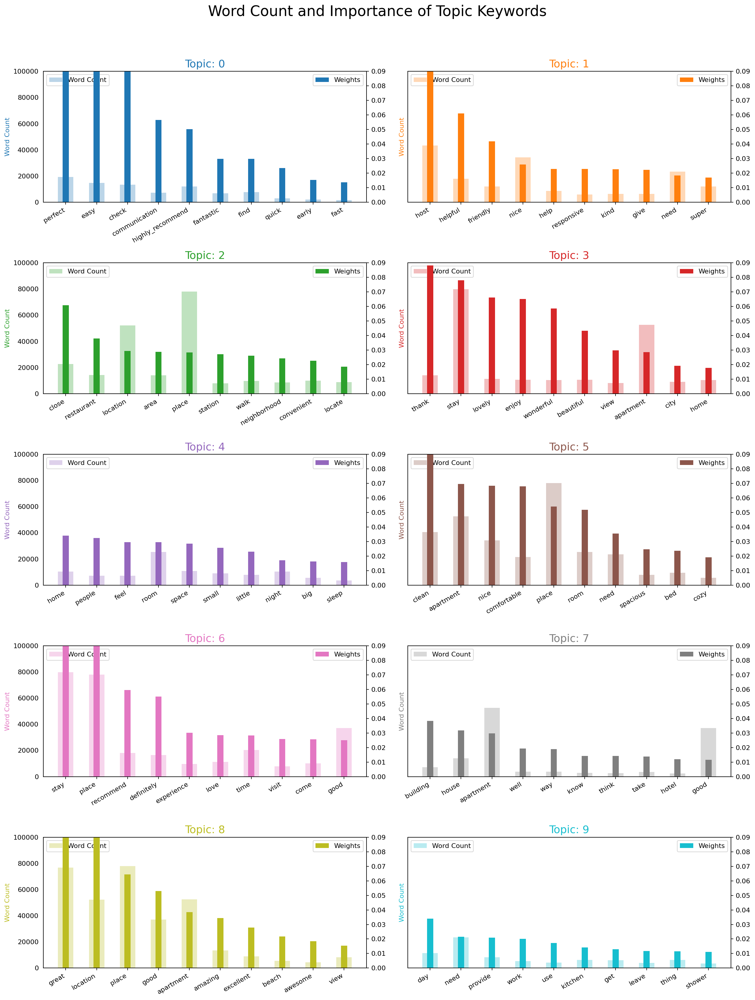

In [182]:
from collections import Counter
topics = lda_model.show_topics(formatted=False)
data_flat = [w for w_list in data_ready for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count']) 

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(5, 2, figsize=(16,20), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.090); ax.set_ylim(0, 100000)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.show()

In [96]:
with open('corpus.pkl', 'rb') as f:
    corpus = pickle.load(f)

In [116]:
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook

# Get topic weights
topic_weights = []
for i, row_list in enumerate(lda_model[corpus]):
    topic_weights.append([w for i, w in row_list[0]])

# Array of topic weights    
arr = pd.DataFrame(topic_weights).fillna(0).values

# Keep the well separated points (optional)
arr = arr[np.amax(arr, axis=1) > 0.35]

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

# tSNE Dimension Reduction
tsne_model = TSNE(n_components=2, verbose=1, random_state=0, angle=.99, init='pca')
tsne_lda = tsne_model.fit_transform(arr)



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 451582 samples in 2.128s...
[t-SNE] Computed neighbors for 451582 samples in 268.404s...
[t-SNE] Computed conditional probabilities for sample 1000 / 451582
[t-SNE] Computed conditional probabilities for sample 2000 / 451582
[t-SNE] Computed conditional probabilities for sample 3000 / 451582
[t-SNE] Computed conditional probabilities for sample 4000 / 451582
[t-SNE] Computed conditional probabilities for sample 5000 / 451582
[t-SNE] Computed conditional probabilities for sample 6000 / 451582
[t-SNE] Computed conditional probabilities for sample 7000 / 451582
[t-SNE] Computed conditional probabilities for sample 8000 / 451582
[t-SNE] Computed conditional probabilities for sample 9000 / 451582
[t-SNE] Computed conditional probabilities for sample 10000 / 451582
[t-SNE] Computed conditional probabilities for sample 11000 / 451582
[t-SNE] Computed conditional probabilities for sample 12000 / 451582
[t-SNE] Computed conditional proba

[t-SNE] Computed conditional probabilities for sample 126000 / 451582
[t-SNE] Computed conditional probabilities for sample 127000 / 451582
[t-SNE] Computed conditional probabilities for sample 128000 / 451582
[t-SNE] Computed conditional probabilities for sample 129000 / 451582
[t-SNE] Computed conditional probabilities for sample 130000 / 451582
[t-SNE] Computed conditional probabilities for sample 131000 / 451582
[t-SNE] Computed conditional probabilities for sample 132000 / 451582
[t-SNE] Computed conditional probabilities for sample 133000 / 451582
[t-SNE] Computed conditional probabilities for sample 134000 / 451582
[t-SNE] Computed conditional probabilities for sample 135000 / 451582
[t-SNE] Computed conditional probabilities for sample 136000 / 451582
[t-SNE] Computed conditional probabilities for sample 137000 / 451582
[t-SNE] Computed conditional probabilities for sample 138000 / 451582
[t-SNE] Computed conditional probabilities for sample 139000 / 451582
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 247000 / 451582
[t-SNE] Computed conditional probabilities for sample 248000 / 451582
[t-SNE] Computed conditional probabilities for sample 249000 / 451582
[t-SNE] Computed conditional probabilities for sample 250000 / 451582
[t-SNE] Computed conditional probabilities for sample 251000 / 451582
[t-SNE] Computed conditional probabilities for sample 252000 / 451582
[t-SNE] Computed conditional probabilities for sample 253000 / 451582
[t-SNE] Computed conditional probabilities for sample 254000 / 451582
[t-SNE] Computed conditional probabilities for sample 255000 / 451582
[t-SNE] Computed conditional probabilities for sample 256000 / 451582
[t-SNE] Computed conditional probabilities for sample 257000 / 451582
[t-SNE] Computed conditional probabilities for sample 258000 / 451582
[t-SNE] Computed conditional probabilities for sample 259000 / 451582
[t-SNE] Computed conditional probabilities for sample 260000 / 451582
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 367000 / 451582
[t-SNE] Computed conditional probabilities for sample 368000 / 451582
[t-SNE] Computed conditional probabilities for sample 369000 / 451582
[t-SNE] Computed conditional probabilities for sample 370000 / 451582
[t-SNE] Computed conditional probabilities for sample 371000 / 451582
[t-SNE] Computed conditional probabilities for sample 372000 / 451582
[t-SNE] Computed conditional probabilities for sample 373000 / 451582
[t-SNE] Computed conditional probabilities for sample 374000 / 451582
[t-SNE] Computed conditional probabilities for sample 375000 / 451582
[t-SNE] Computed conditional probabilities for sample 376000 / 451582
[t-SNE] Computed conditional probabilities for sample 377000 / 451582
[t-SNE] Computed conditional probabilities for sample 378000 / 451582
[t-SNE] Computed conditional probabilities for sample 379000 / 451582
[t-SNE] Computed conditional probabilities for sample 380000 / 451582
[t-SNE] Computed con

Loading BokehJS ...

In [167]:
from bokeh.palettes import Spectral4
import re
# Plot the Topic Clusters using Bokeh
output_notebook()

target_ids = range(len(set(topic_num)))

#mycolors = np.array([color for name, color in mcolors.CSS4_COLORS.items()])
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])
plot = figure(title="t-SNE Clustering of {} LDA Topics".format(n_topics), 
              plot_width=1000, plot_height=1000)
labels = map(str, sorted(pd.Series(topic_num).drop_duplicates().tolist()))
for i, color, label in zip(target_ids, mycolors, labels):
    plot.scatter(x=tsne_lda[topic_num==i,0], y=tsne_lda[topic_num==i,1], color=color, legend_label=label)
plot.legend.location = "top_left"
show(plot)

Loading BokehJS ...

In [164]:
labels = map(str, sorted(pd.Series(topic_num).drop_duplicates().tolist()))

In [166]:
for label in labels:
    print(type(label))

In [147]:
target_ids = range(len(set(topic_num)))
target_ids

range(0, 10)

In [168]:
with open('id2word.pkl', 'rb') as f:
    id2word = pickle.load(f)

In [169]:
import pyLDAvis
import pyLDAvis.gensim  # don't skip this
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, corpus, id2word, sort_topics=False)
vis

IndexError: index 7882 is out of bounds for axis 1 with size 7882

In [ ]:
a = lda_model.show_topics(num_topics=20,formatted=False,num_words=10)
b = lda_model.top_topics(corpus,dictionary=id2word,topn=10) # This orders the topics in the decreasing order of coherence score

topic2skillb = {}
topic2csb = {}
topic2skilla = {}
topic2csa = {}
num_topics =lda_model.num_topics
cnt =1

for ws in b:
    wset = set(w[1] for w in ws[0])
    topic2skillb[cnt] = wset
    topic2csb[cnt] = ws[1]
    cnt +=1

for ws in a:
    wset = set(w[0]for w in ws[1])
    topic2skilla[ws[0]+1] = wset
    
for i in range(1,num_topics+1):
    for j in range(1,num_topics+1):  
        if topic2skilla[i].intersection(topic2skillb[j])==topic2skilla[i]:
            topic2csa[i] = topic2csb[j]

finalData = pd.DataFrame([],columns=['Topic','Words'])
finalData['Topic']=topic2skilla.keys() 
finalData['Topic'] = finalData['Topic'].apply(lambda x: 'Topic'+str(x))
finalData['Top Words']=topic2skilla.values()
finalData['Coherence'] = topic2csa.values()
finalData.sort_values(by='Coherence',ascending=False,inplace=True)
finalData.to_csv('CoherenceScore.csv')
finalData.drop('Words', axis=1, inplace=True)

In [ ]:
finalData

In [ ]:
pd.set_option('display.max_colwidth', None)
token_percent = vis.topic_coordinates.sort_values(by='topics').loc[:,['topics','Freq']]
final = finalData.merge(token_percent, left_index=True, right_index=True)
final = final.drop('topics', axis=1)
final = final.rename(columns = {'Freq':'Token percentage'})
final

In [ ]:
def get_relevant_words(vis,lam=0.3,topn=10):
    a = vis.topic_info
    a['finalscore'] = a['logprob']*lam+(1-lam)*a['loglift']
    a = a.loc[:,['Category','Term','finalscore']].groupby(['Category'])\
    .apply(lambda x: x.sort_values(by='finalscore',ascending=False).head(topn))
    a = a.loc[:,'Term'].reset_index().loc[:,['Category','Term']]
    a = a[a['Category']!='Default']
    a = a.to_dict('split')['data']
    d ={}
    for k,v in a: 
        if k not in d.keys():
            d[k] =set()
            d[k].add(v)
        else:
            d[k].add(v)
    finalData = pd.DataFrame([],columns=['Topic','Relevant words'])
    finalData['Topic']=d.keys()
    finalData['Relevant words']=d.values()
    return finalData

In [ ]:
relevant_words = get_relevant_words(vis,0.3).merge(final,how='left',on ='Topic').sort_values(by='Coherence',ascending=False).drop('Top Words', axis=1)
relevant_words